In [1]:
import numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
from wordcloud import WordCloud

data = pd.read_csv("../input/train.csv", parse_dates = ["activation_date"])

In [2]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1503424 entries, 0 to 1503423
Data columns (total 18 columns):
item_id                 1503424 non-null object
user_id                 1503424 non-null object
region                  1503424 non-null object
city                    1503424 non-null object
parent_category_name    1503424 non-null object
category_name           1503424 non-null object
param_1                 1441848 non-null object
param_2                 848882 non-null object
param_3                 640859 non-null object
title                   1503424 non-null object
description             1387148 non-null object
price                   1418062 non-null float64
item_seq_number         1503424 non-null int64
activation_date         1503424 non-null datetime64[ns]
user_type               1503424 non-null object
image                   1390836 non-null object
image_top_1             1390836 non-null float64
deal_probability        1503424 non-null float64
dtypes: datetim

In [3]:
data.describe()

,price,item_seq_number,image_top_1,deal_probability
count,1.418062e+06,1.503424e+06,1.390836e+06,1.503424e+06
mean,3.167081e+05,7.436740e+02,1.241932e+03,1.391306e-01
std,6.689154e+07,5.572522e+03,9.704641e+02,2.600785e-01
min,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00
25%,5.000000e+02,9.000000e+00,4.250000e+02,0.000000e+00
50%,1.300000e+03,2.900000e+01,1.057000e+03,0.000000e+00
75%,7.000000e+03,8.800000e+01,2.217000e+03,1.508700e-01
max,7.950101e+10,2.044290e+05,3.066000e+03,1.000000e+00


In [4]:
data.head()

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
0,b912c3c6a6ad,e00f8ff2eaf9,Свердловская область,Екатеринбург,Личные вещи,Товары для детей и игрушки,Постельные принадлежности,NaN,NaN,Кокоби(кокон для сна),"Кокон для сна малыша,пользовались меньше месяц...",400.0,2,2017-03-28,Private,d10c7e016e03247a3bf2d13348fe959fe6f436c1caf64c...,1008.0,0.12789
1,2dac0150717d,39aeb48f0017,Самарская область,Самара,Для дома и дачи,Мебель и интерьер,Другое,NaN,NaN,Стойка для Одежды,"Стойка для одежды, под вешалки. С бутика.",3000.0,19,2017-03-26,Private,79c9392cc51a9c81c6eb91eceb8e552171db39d7142700...,692.0,0.00000
2,ba83aefab5dc,91e2f88dd6e3,Ростовская область,Ростов-на-Дону,Бытовая электроника,Аудио и видео,"Видео, DVD и Blu-ray плееры",NaN,NaN,Philips bluray,"В хорошем состоянии, домашний кинотеатр с blu ...",4000.0,9,2017-03-20,Private,b7f250ee3f39e1fedd77c141f273703f4a9be59db4b48a...,3032.0,0.43177
3,02996f1dd2ea,bf5cccea572d,Татарстан,Набережные Челны,Личные вещи,Товары для детей и игрушки,Автомобильные кресла,NaN,NaN,Автокресло,Продам кресло от0-25кг,2200.0,286,2017-03-25,Company,e6ef97e0725637ea84e3d203e82dadb43ed3cc0a1c8413...,796.0,0.80323
4,7c90be56d2ab,ef50846afc0b,Волгоградская область,Волгоград,Транспорт,Автомобили,С пробегом,ВАЗ (LADA),2110,"ВАЗ 2110, 2003",Все вопросы по телефону.,40000.0,3,2017-03-16,Private,54a687a3a0fc1d68aed99bdaaf551c5c70b761b16fd0a2...,2264.0,0.20797


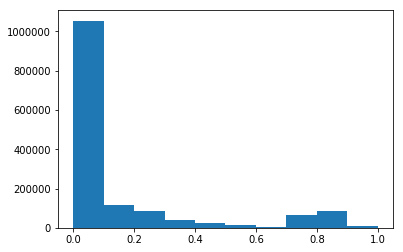

In [5]:
plt.plot(figsize = (15, 10))
plt.hist(data["deal_probability"], bins = 10)
plt.show()

## User Id

In [6]:
print("Number of unique users {}".format(len(data["user_id"].unique())))

Number of unique users 771769


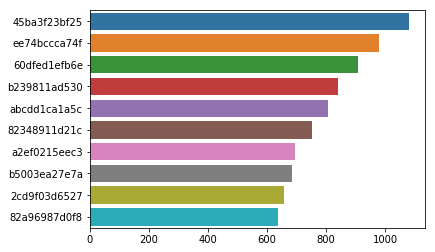

In [7]:
user_count = data["user_id"].value_counts()
top_ten_sellers = user_count[:10]
plt.plot(figsize = (10, 10))
sns.barplot(top_ten_sellers.values, top_ten_sellers.index)
plt.show()

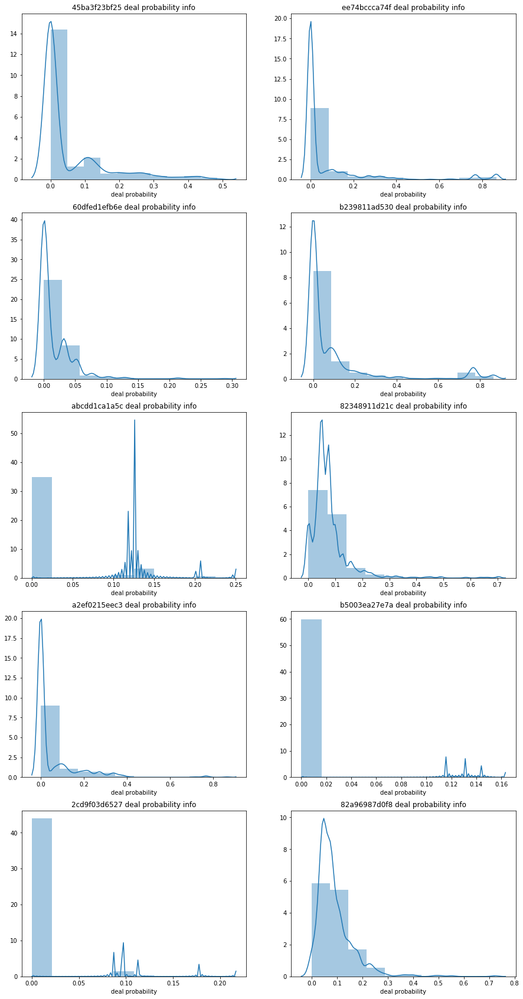

In [8]:
fig, ax = plt.subplots(5, 2, figsize = (15, 30))
for seller in range(10):
    sell_info = data[data["user_id"] == top_ten_sellers.index[seller]]["deal_probability"]
    sns.distplot(sell_info, bins = 10, hist = True, ax = ax[int(seller/2)][seller%2])
    ax[int(seller/2)][seller%2].set_xlabel("deal probability")
    ax[int(seller/2)][seller%2].set_title("{} deal probability info".format(top_ten_sellers.index[seller]))
plt.show()

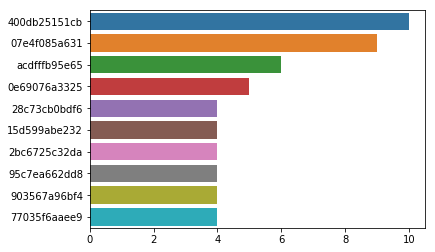

In [9]:
good_seller = data[data["deal_probability"] >= 0.9]["user_id"]
plt.plot(figsize = (10, 15))
sns.barplot(good_seller.value_counts()[:10].values, good_seller.value_counts()[:10].index)
plt.show()

## Categorical Features

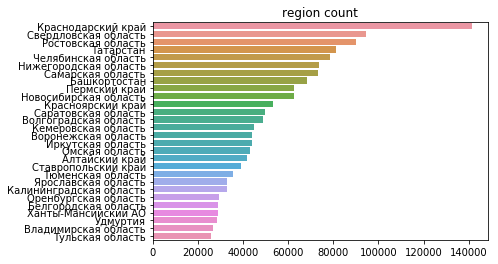

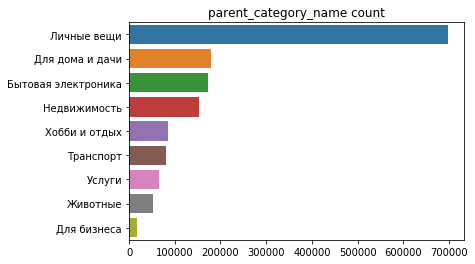

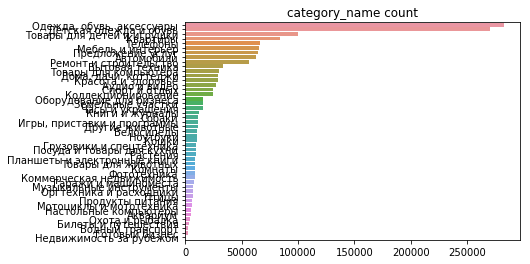

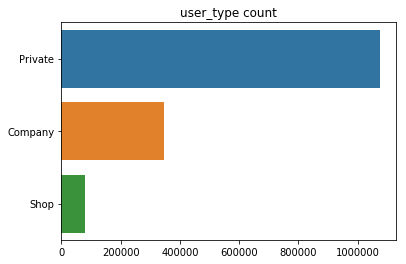

In [10]:
categories = ["region", "parent_category_name", "category_name", "user_type"]
plt.plot(figsize = (10, 15))
for cat in categories:
    count = data[cat].value_counts()
    sns.barplot(count.values, count.index)
    plt.title("{} count".format(cat))
    plt.show()

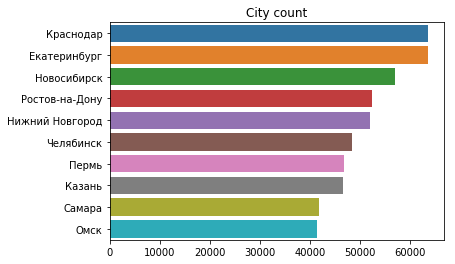

In [11]:
plt.plot(figsize = (10, 15))
count = data["city"].value_counts()[:10]
sns.barplot(count.values, count.index)
plt.title("City count")
plt.show()

## Params

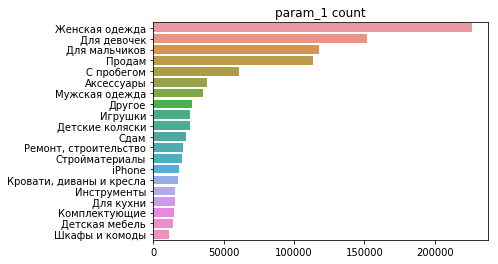

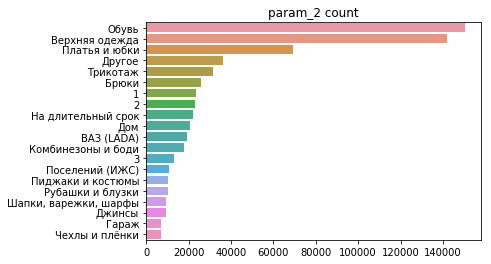

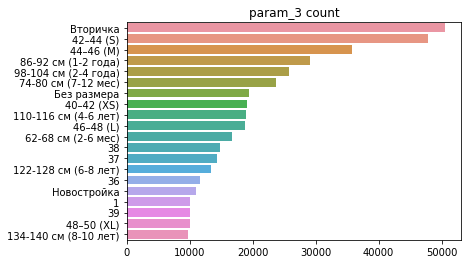

In [12]:
param = ["param_1", "param_2", "param_3"]
plt.plot(figsize = (10, 15))
for p in param:
    count = data[p].value_counts()[:20]
    sns.barplot(count.values, count.index)
    plt.title("{} count".format(p))
    plt.show()

## Item Seq Number

In [13]:
print("Number of unique items {}".format(len(data["item_seq_number"].unique())))

Number of unique items 28232


In [14]:
some_sellers = data["user_id"].value_counts().index[:5]
for s in some_sellers:
    print("Seller {} products".format(s))
    print(data[data["user_id"] == s]["item_seq_number"][:5])

Seller 45ba3f23bf25 products
1333    72090
4062    71290
5514    71448
5576    71140
6780    71914
Name: item_seq_number, dtype: int64
Seller ee74bccca74f products
1056     22571
1557     22723
3487     23288
5833     23012
11298    23038
Name: item_seq_number, dtype: int64
Seller 60dfed1efb6e products
103     33078
2608    33210
3042    33240
5366    33357
8541    33543
Name: item_seq_number, dtype: int64
Seller b239811ad530 products
100     54418
2913    54184
3785    54009
5819    53962
6306    53926
Name: item_seq_number, dtype: int64
Seller abcdd1ca1a5c products
1091    21832
3623    21393
4628    21601
9246    21767
9269    21478
Name: item_seq_number, dtype: int64


In [15]:
item_seq_num_count = data["item_seq_number"].value_counts()
item_seq_num_count[:10]

1     90378
2     58481
3     48047
4     42074
5     37679
6     34629
7     32102
8     29905
9     28221
10    26899
Name: item_seq_number, dtype: int64

In [16]:
item_seq_number1 = data[data["item_seq_number"] == 1]
item_seq_number1[:10]

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
34,2285e797fe2d,5977e301114d,Саратовская область,Саратов,Транспорт,Автомобили,С пробегом,Audi,80,"Audi 80, 1986","Отличный надёжный немец, на очень бодром ходу!...",65000.0,1,2017-03-25,Private,9dc0755c29addc765567c613087fbcabfd62f1555772f4...,1132.0,0.67548
49,a285d4daec8a,e76f336932dc,Пермский край,Пермь,Личные вещи,Красота и здоровье,Приборы и аксессуары,NaN,NaN,Набор для маникюра,Продам набор всё для маникюра /\nИспользовала ...,5000.0,1,2017-03-17,Private,5e81097b80319562099bce5d0847433444ee5b51da1afa...,1039.0,0.15719
92,c2468f15b136,451e557a9de6,Краснодарский край,Петровская,Для дома и дачи,Продукты питания,NaN,NaN,NaN,Яйцо куриное,Яйцо домашние всегда свежее.,60.0,1,2017-03-19,Private,NaN,NaN,0.11508
94,e82d211653ae,479530574f40,Омская область,Омск,Личные вещи,"Одежда, обувь, аксессуары",Женская одежда,Свадебные платья,40–42 (XS),Новые свадебные платья,"Закрыла салон в прошлом году, платья новые, п...",8500.0,1,2017-03-23,Private,23dec721e37db33b2b11ca151174fa589dc3d8040ba682...,560.0,0.00000
135,aee328ab0cf6,4013e81e0a76,Татарстан,Казань,Транспорт,Автомобили,С пробегом,ГАЗ,ГАЗель,"ГАЗ ГАЗель, 2010",Газель в отличном состоянии. Двигатель от Уаза...,300000.0,1,2017-03-15,Private,8b095c09157ed9783fc3adf3eb1e8578434ed483f10988...,1055.0,0.00000
148,258b5172a67b,cdb504ba77b6,Волгоградская область,Волгоград,Недвижимость,Гаражи и машиноместа,Продам,Гараж,Металлический,"Гараж, 12 м²","продаю гараж, имеется смотровая яма, погреб, э...",85000.0,1,2017-03-28,Private,NaN,NaN,0.12981
151,faca2386e135,b7d8629ae841,Нижегородская область,Сосновское,Недвижимость,"Дома, дачи, коттеджи",Продам,Дом,NaN,Дом 35.9 м² на участке 30 сот.,Продаю дом в хорошем состоянии.Две светлые ком...,800000.0,1,2017-03-27,Private,4d6180fbe6033087150ca7e7c7ee82cd65a5494166ad4f...,1516.0,0.20952
174,2bef5deb2c5f,e0c3868a7615,Краснодарский край,Ильский,Услуги,Предложение услуг,"Транспорт, перевозки",Переезды,NaN,Грузоперевозки,Доставка грузов по району и краю по доступным ...,350.0,1,2017-03-27,Private,64e8112d12f57e03ee21e5e9ecf0220366801523335b81...,1203.0,0.00000
184,583e51812631,5fb3ed5df853,Саратовская область,Саратов,Услуги,Предложение услуг,"Ремонт, строительство",Отделочные работы,NaN,Отделка,Выполним работы по отделке квартир коттеджей и...,NaN,1,2017-03-19,Private,9849d8ec29d6202e70859f97bc1eb7aed61e0020a40e6c...,1429.0,0.00000
191,85b007444f5a,bd759bb532e6,Оренбургская область,Октябрьское,Бытовая электроника,"Игры, приставки и программы",Игровые приставки,NaN,NaN,Xbox 360,"+5 игар фифа15,16 мартол комбат 9, гта5,асасси...",7000.0,1,2017-03-28,Private,6a9d3c3a0af20112453b6bdf690259a3902f705ab26a6c...,2901.0,0.16555


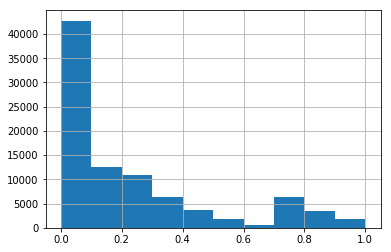

In [17]:
item_seq_number1["deal_probability"].hist()

In [18]:
item_seq_number2 = data[data["item_seq_number"] == 2]
item_seq_number2[:10]

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
0,b912c3c6a6ad,e00f8ff2eaf9,Свердловская область,Екатеринбург,Личные вещи,Товары для детей и игрушки,Постельные принадлежности,NaN,NaN,Кокоби(кокон для сна),"Кокон для сна малыша,пользовались меньше месяц...",400.0,2,2017-03-28,Private,d10c7e016e03247a3bf2d13348fe959fe6f436c1caf64c...,1008.0,0.12789
66,c6239fc67a6f,9c9c9121ba17,Краснодарский край,Краснодар,Услуги,Предложение услуг,"Красота, здоровье",NaN,NaN,"Наращивание ногтей, коррекция","Мастер с 9 летним стажем ждет Вас, красавицы! ...",500.0,2,2017-03-25,Private,4e46c9df2524b3128f47af23cb00d62754bc8769625e11...,2275.0,1.00000
158,e1dbe99ed65c,48bbec76002e,Самарская область,Самара,Личные вещи,"Одежда, обувь, аксессуары",Женская одежда,Другое,NaN,Шорты,"Спортивные шорты, новые. Размер 42/44. Р-он к/...",400.0,2,2017-03-21,Private,29fea7cc757a678d4b92f2fae4f09e85a0b26e9ce35c03...,609.0,0.00000
167,9f6010d063a0,ee1cc4641454,Пермский край,Пермь,Услуги,Предложение услуг,"Ремонт, строительство",Сантехника,NaN,Ремонт -установка сан.тех. оборудования,"Канализация, водопровод, отопление.",NaN,2,2017-03-19,Private,NaN,NaN,0.00000
170,a243cb3a2553,3b0eb2a78996,Красноярский край,Красноярск,Транспорт,Автомобили,С пробегом,Toyota,Corolla,"Toyota Corolla, 1993","Продам надежный , крепкий, очень экономичный а...",160000.0,2,2017-03-22,Private,13a95e6c67a5627cbff741d78ae8bae99b2a802275f2c3...,2262.0,0.15667
240,086dc8add767,d36d0ceb198d,Татарстан,Азнакаево,Для дома и дачи,Ремонт и строительство,Инструменты,NaN,NaN,Маска сварочная хамелеон новая,Продам маску сварочную новую не разу не пользо...,3000.0,2,2017-03-16,Private,af5bb9b7c750d4dc471ccc8f6087bd5c8fb415a0d90574...,1219.0,0.29013
333,60f901b510f0,17cacca48883,Ярославская область,Переславль-Залесский,Недвижимость,Земельные участки,Продам,"Сельхозназначения (СНТ, ДНП)",NaN,"Участок 12 сот. (СНТ, ДНП)","Продается земельный участок размером 12,65 сот...",300000.0,2,2017-03-23,Private,b8f631b49ff112e590aff0f585b9f81585599865947633...,2037.0,0.06514
334,349e640ca2ec,dc6f9054cb15,Волгоградская область,Камышин,Для дома и дачи,Продукты питания,NaN,NaN,NaN,Домашние яйца,Продаю домашние куриные яйца,60.0,2,2017-03-19,Private,NaN,NaN,0.12311
360,be846b2f55ca,1ee6bb2860df,Волгоградская область,Волжский,Транспорт,Автомобили,С пробегом,Toyota,Aygo,"Toyota Aygo, 2008",Продается автомобиль TOYOTA AYGO в хорошем сос...,280000.0,2,2017-03-21,Private,cc13372733c75fb21ae5d4fdc44ddad3a02e238356a9fb...,1132.0,0.51629
368,9b536b799166,a8e5bf25869a,Ростовская область,Ростов-на-Дону,Услуги,Предложение услуг,"Ремонт, строительство",Сантехника,NaN,Сантехнические услуги. Отопление.Водяной пол,Производим следующие виды услуг: монтаж новой ...,350.0,2,2017-03-22,Private,7be2c5d8687b9edf6d734061cea3961df2f16dbd4efeff...,2267.0,0.60000


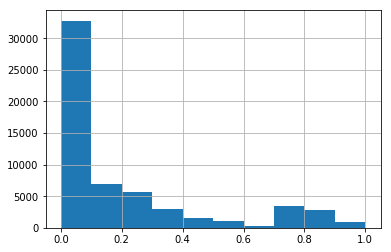

In [19]:
item_seq_number2["deal_probability"].hist()

In [20]:
item_seq_number3 = data[data["item_seq_number"] == 3]
item_seq_number3[:10]

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
4,7c90be56d2ab,ef50846afc0b,Волгоградская область,Волгоград,Транспорт,Автомобили,С пробегом,ВАЗ (LADA),2110,"ВАЗ 2110, 2003",Все вопросы по телефону.,40000.0,3,2017-03-16,Private,54a687a3a0fc1d68aed99bdaaf551c5c70b761b16fd0a2...,2264.0,0.20797
60,fc21a86b9bb0,ab36081b2db1,Татарстан,Зеленодольск,Услуги,Предложение услуг,"Ремонт, строительство","Строительство домов, коттеджей",NaN,Быстровозводимые каркасные строения,В строительстве мы используем и развиваем след...,NaN,3,2017-03-19,Private,NaN,NaN,0.80000
79,1d4c56733bb0,238c695f7127,Саратовская область,Энгельс,Хобби и отдых,Спорт и отдых,Зимние виды спорта,NaN,NaN,Хоккейная форма комплект 50-52 р.р,Продается хоккейная форма полный комплект. Все...,5555.0,3,2017-03-21,Private,b5b3bc3b9aa4d258f98c44a2ec676603598ec27a2a9777...,2638.0,0.00000
97,887ff33257b6,498b64650a13,Новосибирская область,Бердск,Бытовая электроника,Аудио и видео,Телевизоры и проекторы,NaN,NaN,Телевизор цветной,NaN,1300.0,3,2017-03-28,Private,880b578dff8b68ab8e32306acd4a77e2ac88b47e0b1ae1...,3022.0,0.76786
166,c9330f78f8a5,359d91db7c19,Тульская область,Кимовск,Личные вещи,"Одежда, обувь, аксессуары",Женская одежда,Верхняя одежда,44–46 (M),Жилетка,"Продам жилетку из искусственного меха, цвет се...",1000.0,3,2017-03-17,Private,c28cfc7c8db04951443e7d512eee370332bfb32aa59ff4...,531.0,0.22800
179,b4e5a2a13c2a,a91300f7e731,Ростовская область,Гуково,Услуги,Предложение услуг,"Ремонт, строительство","Строительство домов, коттеджей",NaN,Кровля,Кровельные работы любой сложности,99.0,3,2017-03-20,Private,NaN,NaN,0.20000
192,e891f5befeff,1de80c3b63ec,Белгородская область,Грайворон,Недвижимость,Квартиры,Продам,1,Вторичка,"1-к квартира, 34.7 м², 2/4 эт.",Продается 1 комнатная квартира в 4 этажном дом...,NaN,3,2017-03-15,Private,NaN,NaN,0.12895
220,822717f339ec,3280f18cefa5,Новосибирская область,Новосибирск,Личные вещи,Детская одежда и обувь,Для девочек,Верхняя одежда,86-92 см (1-2 года),Кастюм весна-осень,"Кастюм ""шалуны"" наполнитель изософт. до -5. р...",1350.0,3,2017-03-28,Private,06b19fc2684f4435a14751536aa3ef34fe842cbfb8bcfd...,96.0,0.00000
231,44db1bdc8cc9,7aaaf38b240e,Башкортостан,Салават,Недвижимость,Квартиры,Продам,1,Вторичка,"1-к квартира, 34 м², 3/5 эт.","Продам 1-к квартиру с отличным , окна пластико...",1050000.0,3,2017-03-20,Private,3b1ba1569c3a4384c4498f624d8110da00f6eea359e04a...,1487.0,0.27224
253,c8b4f815ea21,e4a591b7e964,Волгоградская область,Волгоград,Услуги,Предложение услуг,"Ремонт, строительство",Сборка и ремонт мебели,NaN,Корпусная мебель на заказ,Мы предлагаем Вам свои услуги по изготовлению ...,NaN,3,2017-03-19,Private,ab384a4e59b3bb65b7783a133a11a4459f07d9ce554fea...,1490.0,0.60000


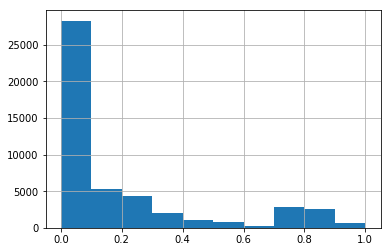

In [21]:
item_seq_number3["deal_probability"].hist()

## Price

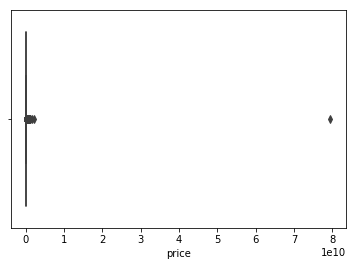

In [22]:
plt.plot(figsize = (10, 10))
sns.boxplot(data["price"])
plt.show()

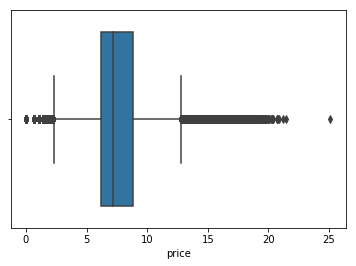

In [23]:
data["price"] = np.log(data["price"] + 1)
plt.plot(figsize = (10, 10))
sns.boxplot(data["price"])
plt.show()

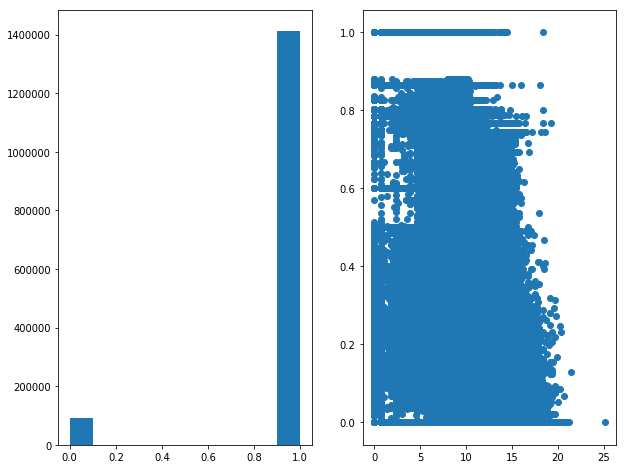

In [24]:
fig, ax = plt.subplots(1, 2, figsize = (10, 8))
ax[0].hist(data["price"] > 0, bins = 10)
ax[1].scatter(data["price"], data["deal_probability"])
plt.show()

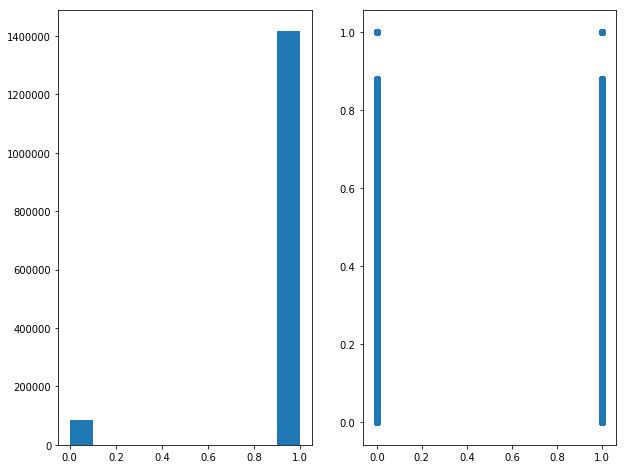

In [25]:
fig, ax = plt.subplots(1, 2, figsize = (10, 8))
ax[0].hist(data["price"] < 150000, bins = 10)
ax[1].scatter(data["price"] < 150000, data["deal_probability"])
plt.show()

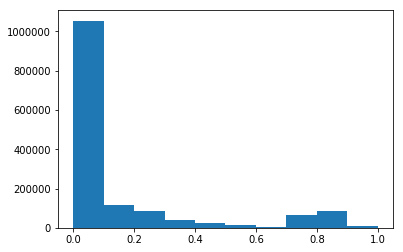

In [26]:
plt.plot(figsize = (15, 10))
plt.hist(data["deal_probability"], bins = 10)
plt.show()

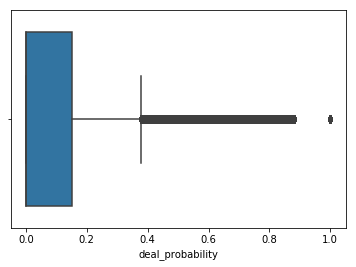

In [27]:
plt.plot(figsize = (15, 10))
sns.boxplot(data["deal_probability"])
plt.show()

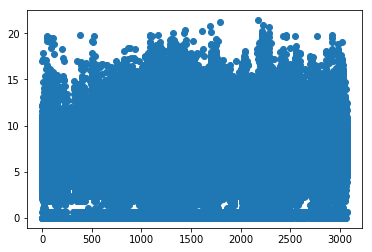

In [28]:
plt.plot(figsize = (15, 10))
plt.scatter(data["image_top_1"], data["price"])
plt.show()

## Image Top 1

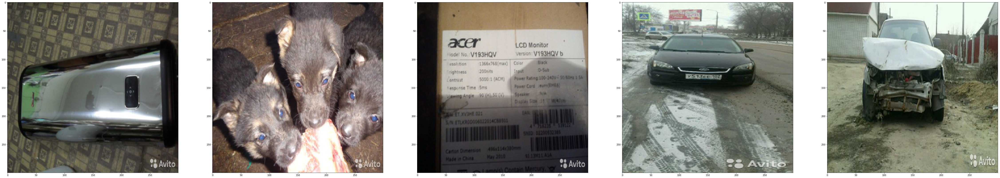

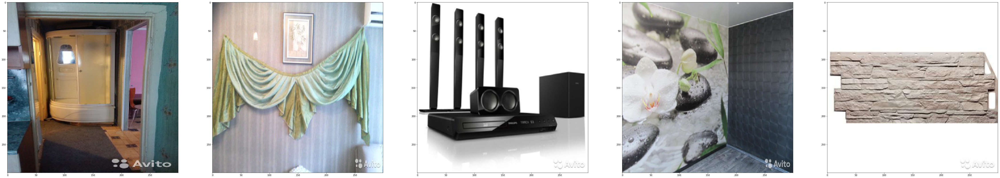

In [29]:
import zipfile
from PIL import Image 
import numpy as np 
from IPython.display import display, HTML

image_top_1_mean = np.mean(data["image_top_1"])
good_images = data[data["image_top_1"] > image_top_1_mean]["image"][:10]
bad_images = data[data["image_top_1"] < image_top_1_mean]["image"][:10]

goodones = []
badones = []
with zipfile.ZipFile("../input/train_jpg.zip", "r") as train_zip:
    files_in_zip = sorted(train_zip.namelist())
    for idx, file in enumerate(files_in_zip):
        if any(file.endswith(x + ".jpg") for x in good_images): 
            img = train_zip.extract(file, path = file.split("/")[3])
            goodones.append(img)
        elif any(file.endswith(x + ".jpg") for x in bad_images): 
            img = train_zip.extract(file, path = file.split("/")[3])
            badones.append(img)

f, ax = plt.subplots(1, 5)
f.set_size_inches(80, 40)
for i in range(5):
    ax[i].imshow(Image.open(goodones[i]).resize((300, 300), Image.ANTIALIAS))
plt.show()

f, ax = plt.subplots(1, 5)
f.set_size_inches(80, 40)
for i in range(5):
    ax[i].imshow(Image.open(goodones[i + 5]).resize((300, 300), Image.ANTIALIAS))
plt.show()

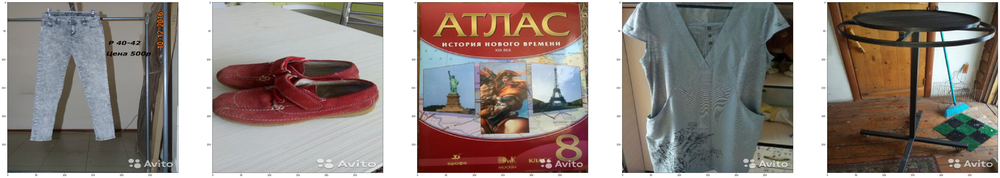

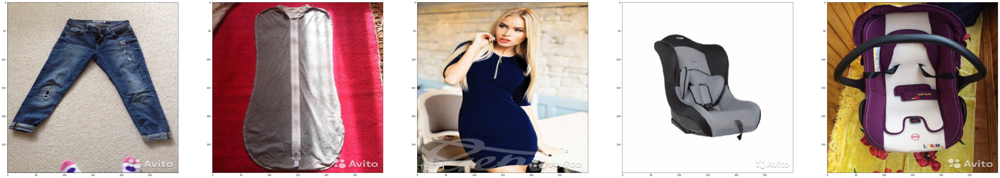

In [30]:
f, ax = plt.subplots(1,5)
f.set_size_inches(80, 40)
for i in range(5):
    ax[i].imshow(Image.open(badones[i]).resize((300, 300), Image.ANTIALIAS))
plt.show()

f, ax = plt.subplots(1,5)
f.set_size_inches(80, 40)
for i in range(5):
    ax[i].imshow(Image.open(badones[i + 5]).resize((300, 300), Image.ANTIALIAS))
plt.show()

In [31]:
print("Number of unique image top 1: {}".format(len(data["image_top_1"].unique())))

Number of unique image top 1: 3063


In [32]:
top_image_top_1 = data["image_top_1"].astype(str).value_counts()[:10]
top_image_top_1

nan       112588
2219.0     18739
1002.0     18646
2918.0     15407
2264.0     14517
2218.0     14415
42.0       12328
47.0       11144
82.0       10939
84.0       10652
Name: image_top_1, dtype: int64

In [33]:
top_5 = [2219.0, 1002.0, 2918.0, 2264.0, 2218.0]
some_images_1 = data[data["image_top_1"] == top_5[0]]["image"][:10]
some_images_2 = data[data["image_top_1"] == top_5[1]]["image"][:10]
some_images_3 = data[data["image_top_1"] == top_5[2]]["image"][:10]
some_images_4 = data[data["image_top_1"] == top_5[3]]["image"][:10]
some_images_5 = data[data["image_top_1"] == top_5[4]]["image"][:10]

In [34]:
images_1 = []
images_2 = []
images_3 = []
images_4 = []
images_5 = []

with zipfile.ZipFile("../input/train_jpg.zip", "r") as train_zip:
    files_in_zip = sorted(train_zip.namelist())
    for idx, file in enumerate(files_in_zip):
        if any(file.endswith(x + ".jpg") for x in some_images_1): 
            img = train_zip.extract(file, path = file.split("/")[3])
            images_1.append(img)
        elif any(file.endswith(x + ".jpg") for x in some_images_2): 
            img = train_zip.extract(file, path = file.split("/")[3])
            images_2.append(img)
        elif any(file.endswith(x + ".jpg") for x in some_images_3): 
            img = train_zip.extract(file, path = file.split("/")[3])
            images_3.append(img)
        elif any(file.endswith(x + ".jpg") for x in some_images_4): 
            img = train_zip.extract(file, path = file.split("/")[3])
            images_4.append(img)
        elif any(file.endswith(x + ".jpg") for x in some_images_5): 
            img = train_zip.extract(file, path = file.split("/")[3])
            images_5.append(img)

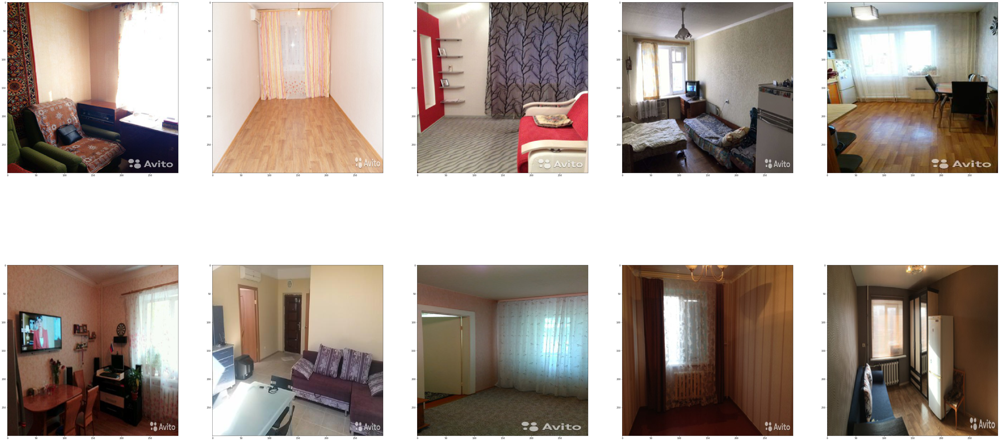

In [35]:
f, ax = plt.subplots(2, 5)
f.set_size_inches(80, 40)
for i in range(10):
    ax[int(i/5)][i%5].imshow(Image.open(images_1[i]).resize((300, 300), Image.ANTIALIAS))
plt.show()

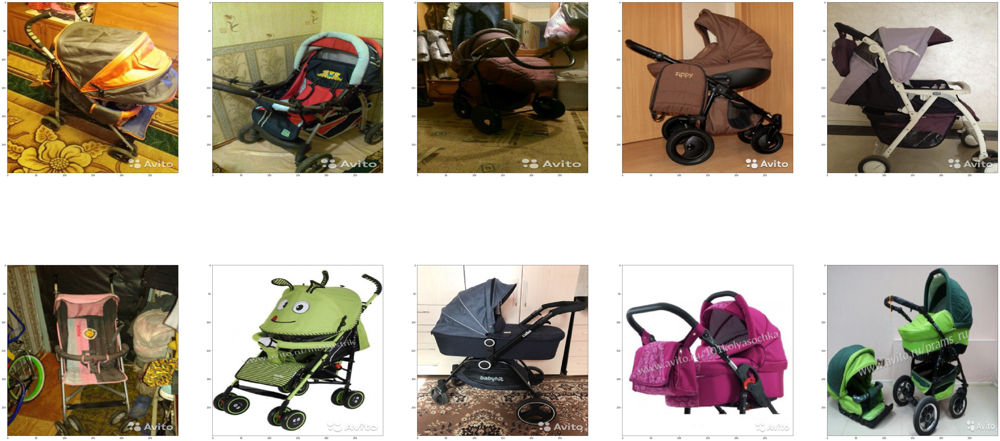

In [36]:
f, ax = plt.subplots(2, 5)
f.set_size_inches(80, 40)
for i in range(10):
    ax[int(i/5)][i%5].imshow(Image.open(images_2[i]).resize((300, 300), Image.ANTIALIAS))
plt.show()

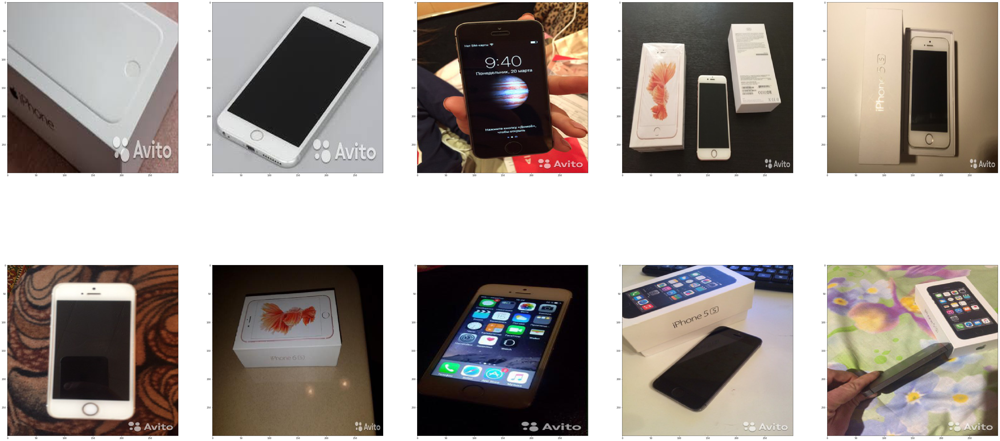

In [37]:
f, ax = plt.subplots(2, 5)
f.set_size_inches(80, 40)
for i in range(10):
    ax[int(i/5)][i%5].imshow(Image.open(images_3[i]).resize((300, 300), Image.ANTIALIAS))
plt.show()

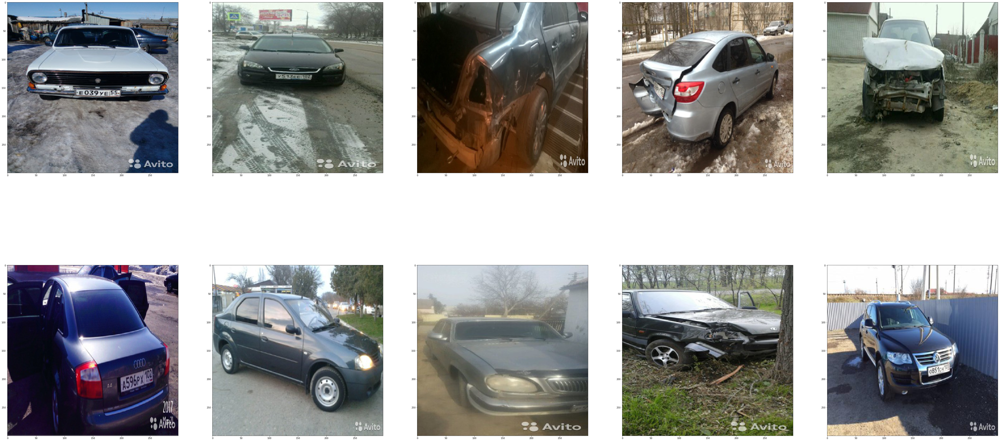

In [38]:
f, ax = plt.subplots(2, 5)
f.set_size_inches(80, 40)
for i in range(10):
    ax[int(i/5)][i%5].imshow(Image.open(images_4[i]).resize((300, 300), Image.ANTIALIAS))
plt.show()

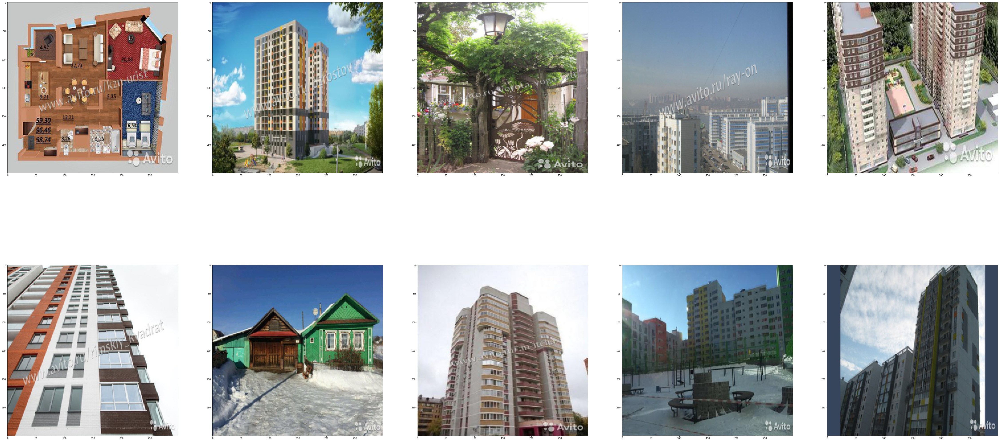

In [39]:
f, ax = plt.subplots(2, 5)
f.set_size_inches(80, 40)
for i in range(10):
    ax[int(i/5)][i%5].imshow(Image.open(images_5[i]).resize((300, 300), Image.ANTIALIAS))
plt.show()

In [40]:
data_active = pd.read_csv("../input/train_active.csv", nrows = 10000)
data_active.head()

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type
0,70d6342079ef,11d4c04d8c51,Нижегородская область,Нижний Новгород,Хобби и отдых,Книги и журналы,Книги,NaN,NaN,Детская знциклопедия,"детская энциклопедия,10 томов, в книге 630 стр...",200.0,20.0,2017-03-15,Private
1,97cf505710e1,d7068c60b2c6,Воронежская область,Воронеж,Недвижимость,Гаражи и машиноместа,Продам,Гараж,Кирпичный,"Гараж, > 30 м²","Продается ГАРАЖ в ПГСК Алмаз/\nУдобный въезд, ...",590000.0,23.0,2017-03-27,Private
2,6a93a31a945d,755c88999bc7,Нижегородская область,Нижний Новгород,Недвижимость,Коммерческая недвижимость,Сдам,Торговое помещение,NaN,"Торговое помещение, 50-5000 м²",Сдаем в аренду лучшие торговые помещения Н.Нов...,100000.0,4.0,2017-03-15,Private
3,050cade37667,3d7fb2abdbbc,Башкортостан,Стерлитамак,Бытовая электроника,Телефоны,Аксессуары,Аккумуляторы,NaN,Аккумулятор на 5s / 5c,"продам батарею на iphone 5s , 5с",750.0,157.0,2017-03-15,Company
4,2935e85aa40b,fc1be1a809d1,Татарстан,Казань,Для дома и дачи,Ремонт и строительство,Камины и обогреватели,NaN,NaN,"Заглушки, дверцы, плита","Всё для печи: плита, заглушка, дверцы- всё нов...",3900.0,27.0,2017-03-15,Private


## Null data

In [41]:
no_price = data[data["price"].isnull()]
no_price.head()

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
24,065a4daba35f,19a5cd02c89b,Нижегородская область,Нижний Новгород,Животные,Товары для животных,NaN,NaN,NaN,Таблетки бравекто,"Таблетки ""Бравекто"" от блох и клещей по ценам:...",NaN,310,2017-03-16,Company,22babf609cfcbca6b1d5ca81321fd6f58e873903c8fc0a...,843.0,0.0
30,af9d5b0eadc9,ff3f46835373,Ростовская область,Аксай,Для дома и дачи,Ремонт и строительство,Стройматериалы,NaN,NaN,Фасадные панели,Уникальные свойства фасадных панелей FineBer п...,NaN,8,2017-03-25,Private,fb5c2ee81f10750f4142d2028707a779c7e95576bb180d...,1282.0,0.0
60,fc21a86b9bb0,ab36081b2db1,Татарстан,Зеленодольск,Услуги,Предложение услуг,"Ремонт, строительство","Строительство домов, коттеджей",NaN,Быстровозводимые каркасные строения,В строительстве мы используем и развиваем след...,NaN,3,2017-03-19,Private,NaN,NaN,0.8
69,a297b829b758,a072669fe34b,Ростовская область,Ростов-на-Дону,Животные,Птицы,NaN,NaN,NaN,"""Индийский бегун"" большого размера","Яйцо на инкубацию уток породы ""Индийский бегун...",NaN,135,2017-03-20,Company,NaN,NaN,0.0
74,1298ab2ff7f3,b94c4c860296,Владимирская область,Муром,Услуги,Предложение услуг,Мастер на час,NaN,NaN,Муж на час или дольше,"предоставляю все виды работ по дому,работаю в ...",NaN,241,2017-03-28,Company,NaN,NaN,0.5


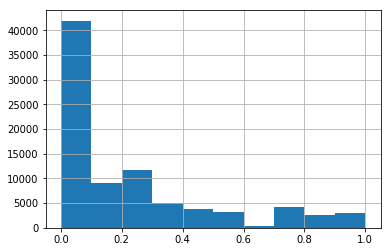

In [42]:
no_price["deal_probability"].hist()

In [43]:
def has_price(descrip):
    comments = str(descrip).split(" ")
    if "руб" in comments:
        return 1
    elif "₽" in comments:
        return 1
    return 0

no_price["hidden_price"] = no_price["description"].apply(lambda x: has_price(x))
no_price["hidden_price"].value_counts()

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':


0    84522
1      840
Name: hidden_price, dtype: int64

In [44]:
no_price[no_price["hidden_price"] == 1].head()

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability,hidden_price
4180,fb9442197268,185cf588bd49,Татарстан,Казань,Услуги,Предложение услуг,"Транспорт, перевозки",Коммерческие перевозки,NaN,Грузоперевозки,Газель изотермо-рефрижератор температура от -2...,NaN,51,2017-03-17,Private,6b5b03915578087f17e3ab9418fbe043d06ebb41a8eafe...,1055.0,1.00000,1
4403,0c685f93a6d7,ed5a683f5aa5,Свердловская область,Екатеринбург,Услуги,Предложение услуг,"Транспорт, перевозки",Коммерческие перевозки,NaN,Грузоперевозки,"город 500руб. час ,межгород 15-17 руб за км",NaN,1,2017-03-28,Private,9980d6bca61c8c4d36dac8445ff1336af11de6e1304383...,1055.0,0.50000,1
4762,3e40dfefae36,9f09d2bdfb16,Волгоградская область,Волгоград,Бытовая электроника,Аудио и видео,Аксессуары,NaN,NaN,Конденсаторы,ROE 1 шт 400 руб/\nMallory каждый по 200 руб/\...,NaN,1,2017-03-15,Private,6e68aeec8631992f2a818c0c19c28402689fff087ffa62...,2785.0,0.16155,1
5179,92bb331965be,552c15b02c0c,Ярославская область,Ярославль,Личные вещи,Детская одежда и обувь,Для мальчиков,Верхняя одежда,122-128 см (6-8 лет),Одежда для мальчиков,Ветровка Bosco 400 руб,NaN,46,2017-03-17,Private,cc09e7b0343b63e74a6a0c92c4b44a1bc52422690e4ad8...,657.0,0.00000,1
6034,6eba44d2ccf6,55bc6f2864cb,Пермский край,Частые,Животные,Другие животные,С/х животные,NaN,NaN,Ярочки романовской породы,продаются ярочки Романовской породы от 2 до 7 ...,NaN,2,2017-03-18,Private,1d6e9cd8a63e57c469cf18a6cc9016d1801eedc1088f57...,2194.0,0.22522,1


In [45]:
no_images = data[data["image"].isnull()]
no_images.head()

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
19,0658628930d4,27c2d83b766e,Белгородская область,Белгород,Недвижимость,"Дома, дачи, коттеджи",Сниму,Коттедж,На длительный срок,Сниму коттедж,Семейная пара из двух человек снимет коттедж с...,11.512935,5,2017-03-28,Private,NaN,NaN,0.10342
21,838a82cec0a6,5d44315f6d90,Свердловская область,Екатеринбург,Личные вещи,"Одежда, обувь, аксессуары",Женская одежда,Верхняя одежда,> 50 (XXL),Шапка норковая,"Продам шапку, норка, цвет коричневый, в отличн...",7.863651,33,2017-03-16,Private,NaN,NaN,0.00000
32,d0e88acda491,5646036467ec,Пермский край,Пермь,Бытовая электроника,Товары для компьютера,Комплектующие,Системы охлаждения,NaN,Кулер для компьютера cooler master,Чтобы посмотреть весь ассортимент нашего магаз...,5.707110,3377,2017-03-18,Shop,NaN,NaN,0.00000
38,f55eed4e831e,7e8eb4a5d1d5,Калининградская область,Гвардейск,Недвижимость,Коммерческая недвижимость,Продам,Складское помещение,NaN,Склад 70 м²,"Продается склад ГСМ, по адресу п. Истровка, Ка...",13.592368,6004,2017-03-28,Shop,NaN,NaN,0.06626
55,f893190597f3,b9d8c15c0f89,Челябинская область,Челябинск,Недвижимость,Комнаты,Сниму,На длительный срок,NaN,Сниму комнату,Девушка без вредных привычек ... Снимет кварт...,8.699681,9,2017-03-19,Private,NaN,NaN,0.19173


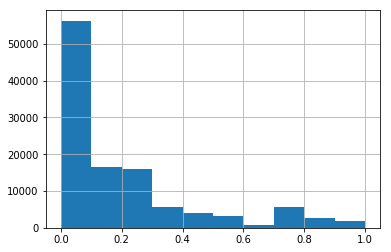

In [46]:
no_images["deal_probability"].hist()

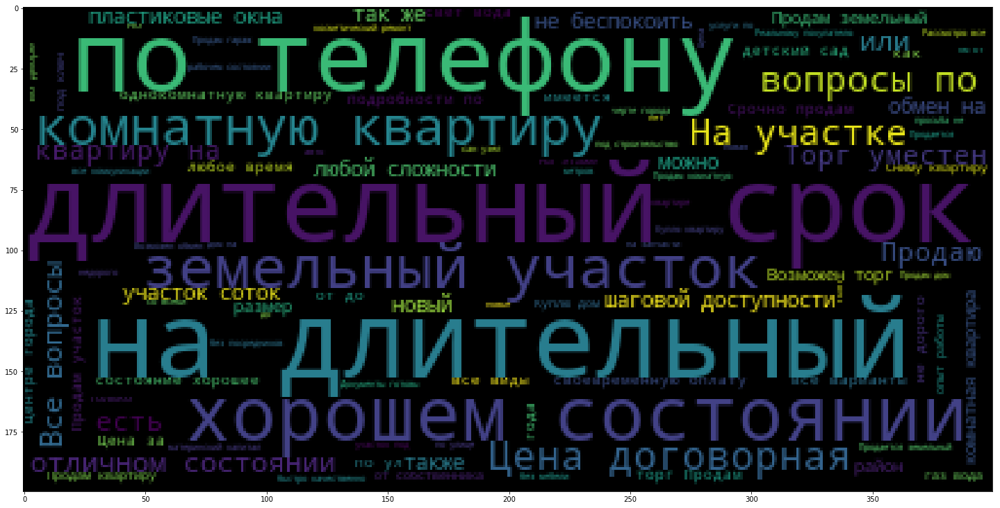

In [47]:
plt.figure(figsize = (25, 15))
wordcloud = WordCloud(max_words = 100).generate(" ".join(no_images["description"].astype(str)))
plt.imshow(wordcloud)
plt.show()

In [48]:
no_price_and_no_image = data[data["price"].isnull() & data["image"].isnull()]
no_price_and_no_image.head()

,item_id,user_id,region,city,parent_category_name,category_name,param_1,param_2,param_3,title,description,price,item_seq_number,activation_date,user_type,image,image_top_1,deal_probability
60,fc21a86b9bb0,ab36081b2db1,Татарстан,Зеленодольск,Услуги,Предложение услуг,"Ремонт, строительство","Строительство домов, коттеджей",NaN,Быстровозводимые каркасные строения,В строительстве мы используем и развиваем след...,NaN,3,2017-03-19,Private,NaN,NaN,0.80000
69,a297b829b758,a072669fe34b,Ростовская область,Ростов-на-Дону,Животные,Птицы,NaN,NaN,NaN,"""Индийский бегун"" большого размера","Яйцо на инкубацию уток породы ""Индийский бегун...",NaN,135,2017-03-20,Company,NaN,NaN,0.00000
74,1298ab2ff7f3,b94c4c860296,Владимирская область,Муром,Услуги,Предложение услуг,Мастер на час,NaN,NaN,Муж на час или дольше,"предоставляю все виды работ по дому,работаю в ...",NaN,241,2017-03-28,Company,NaN,NaN,0.50000
91,4702f3941947,3fba0d757470,Иркутская область,Братск,Недвижимость,Земельные участки,Продам,Промназначения,NaN,Участок 7 сот. (промназначения),Продам участок под строительство торгового пав...,NaN,58,2017-03-15,Company,NaN,NaN,0.08665
167,9f6010d063a0,ee1cc4641454,Пермский край,Пермь,Услуги,Предложение услуг,"Ремонт, строительство",Сантехника,NaN,Ремонт -установка сан.тех. оборудования,"Канализация, водопровод, отопление.",NaN,2,2017-03-19,Private,NaN,NaN,0.00000


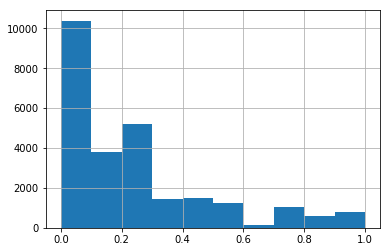

In [49]:
no_price_and_no_image["deal_probability"].hist()

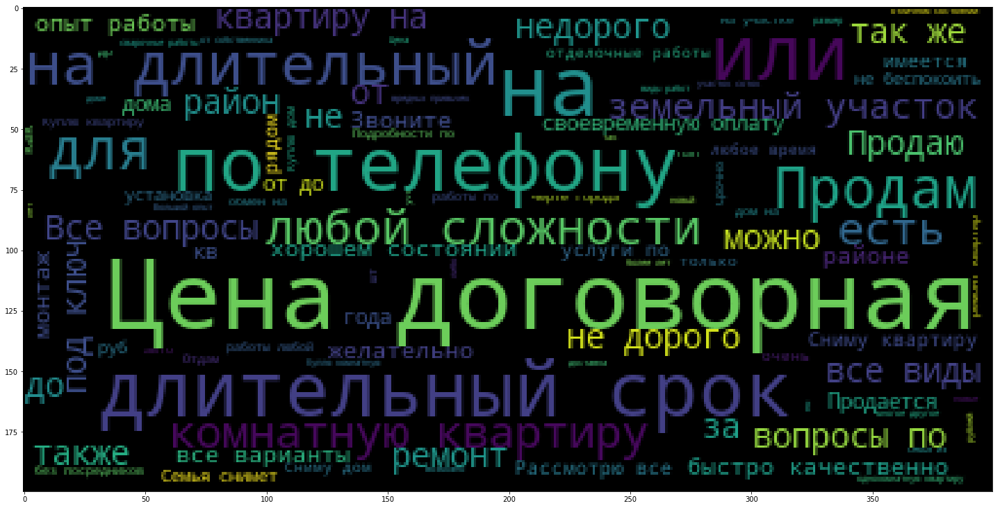

In [50]:
plt.figure(figsize = (25, 15))
wordcloud = WordCloud(max_words = 100).generate(" ".join(no_price_and_no_image["description"].astype(str)))
plt.imshow(wordcloud)
plt.show()

In [51]:
test = pd.read_csv("../input/test.csv", parse_dates = ["activation_date"])

In [52]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 508438 entries, 0 to 508437
Data columns (total 17 columns):
item_id                 508438 non-null object
user_id                 508438 non-null object
region                  508438 non-null object
city                    508438 non-null object
parent_category_name    508438 non-null object
category_name           508438 non-null object
param_1                 485528 non-null object
param_2                 275209 non-null object
param_3                 202107 non-null object
title                   508438 non-null object
description             508438 non-null object
price                   477853 non-null float64
item_seq_number         508438 non-null int64
activation_date         508438 non-null datetime64[ns]
user_type               508438 non-null object
image                   465829 non-null object
image_top_1             465829 non-null float64
dtypes: datetime64[ns](1), float64(2), int64(1), object(13)
memory usage: 65.9+ M

In [53]:
test_user_id = test["user_id"]
print(len(list(set(data["user_id"]).intersection(set(test_user_id)))))

67929


## Zero Deal Probability

In [54]:
zero_deal_probability = data[data["deal_probability"] == 0.0]

In [55]:
zero_deal_probability.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 974618 entries, 1 to 1503423
Data columns (total 18 columns):
item_id                 974618 non-null object
user_id                 974618 non-null object
region                  974618 non-null object
city                    974618 non-null object
parent_category_name    974618 non-null object
category_name           974618 non-null object
param_1                 938038 non-null object
param_2                 573444 non-null object
param_3                 463944 non-null object
title                   974618 non-null object
description             883735 non-null object
price                   937867 non-null float64
item_seq_number         974618 non-null int64
activation_date         974618 non-null datetime64[ns]
user_type               974618 non-null object
image                   933911 non-null object
image_top_1             933911 non-null float64
deal_probability        974618 non-null float64
dtypes: datetime64[ns](1), float

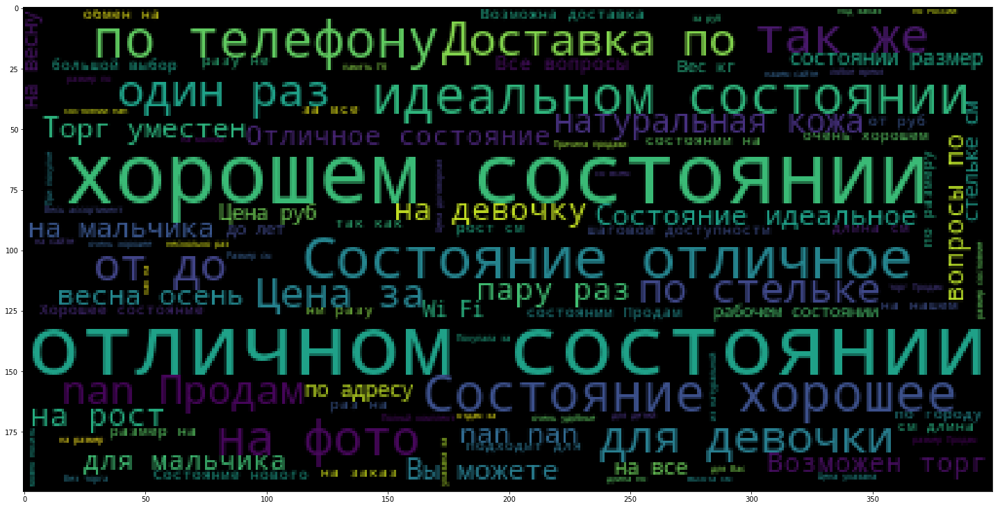

In [56]:
plt.figure(figsize = (25, 15))
wordcloud = WordCloud(max_words = 100).generate(" ".join(zero_deal_probability["description"].astype(str)))
plt.imshow(wordcloud)
plt.show()

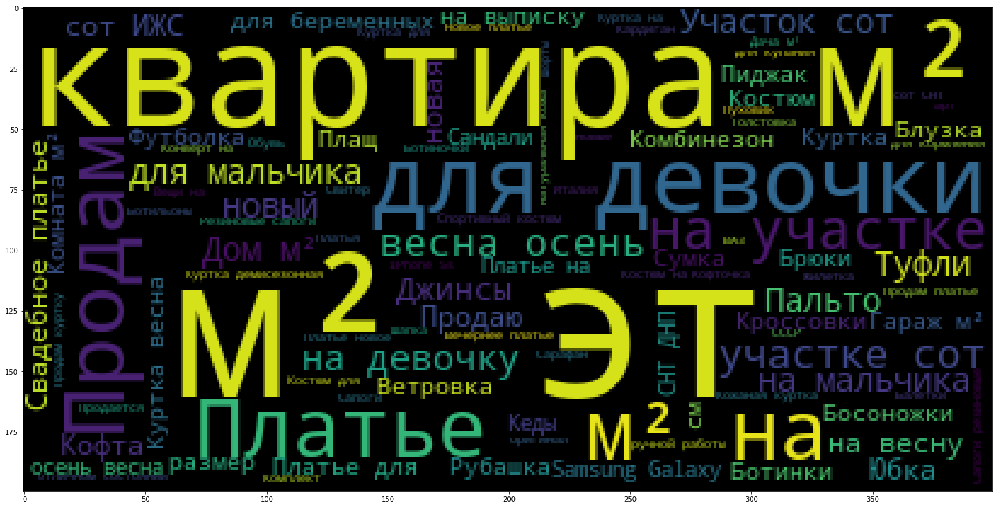

In [57]:
plt.figure(figsize = (25, 15))
wordcloud = WordCloud(max_words = 100).generate(" ".join(zero_deal_probability["title"].astype(str)))
plt.imshow(wordcloud)
plt.show()

## 1.0 Deal Probability

In [58]:
one_deal_probability = data[data["deal_probability"] == 1.0]

In [59]:
one_deal_probability.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10076 entries, 65 to 1503079
Data columns (total 18 columns):
item_id                 10076 non-null object
user_id                 10076 non-null object
region                  10076 non-null object
city                    10076 non-null object
parent_category_name    10076 non-null object
category_name           10076 non-null object
param_1                 10036 non-null object
param_2                 7428 non-null object
param_3                 0 non-null object
title                   10076 non-null object
description             10076 non-null object
price                   7084 non-null float64
item_seq_number         10076 non-null int64
activation_date         10076 non-null datetime64[ns]
user_type               10076 non-null object
image                   8142 non-null object
image_top_1             8142 non-null float64
deal_probability        10076 non-null float64
dtypes: datetime64[ns](1), float64(3), int64(1), object(13

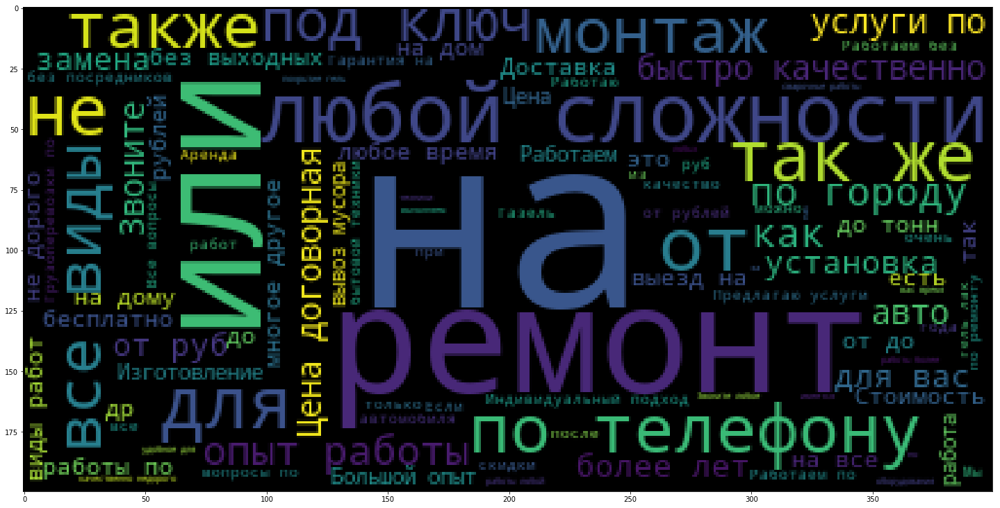

In [60]:
plt.figure(figsize = (25, 15))
wordcloud = WordCloud(max_words = 100).generate(" ".join(one_deal_probability["description"].astype(str)))
plt.imshow(wordcloud)
plt.show()

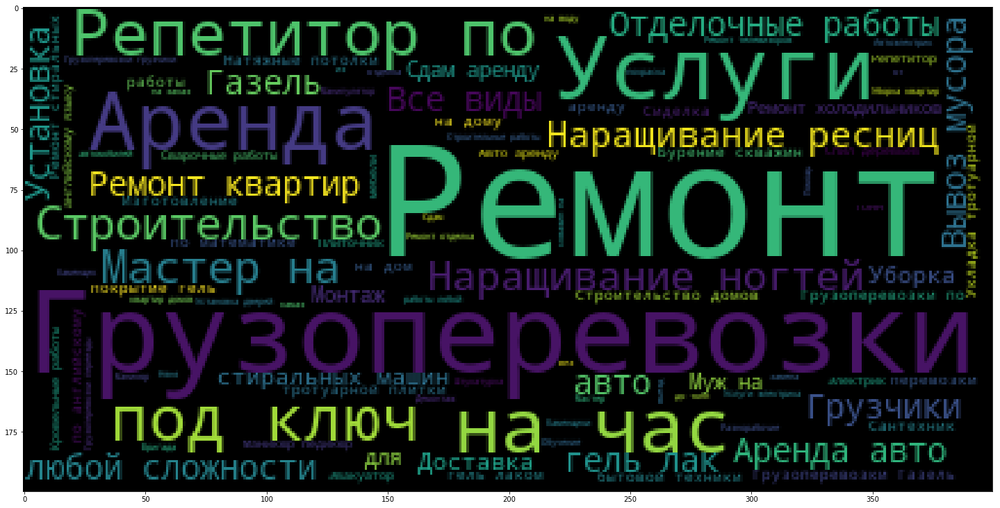

In [61]:
plt.figure(figsize = (25, 15))
wordcloud = WordCloud(max_words = 100).generate(" ".join(one_deal_probability["title"].astype(str)))
plt.imshow(wordcloud)
plt.show()